In [1]:
import os
import time
import shutil
import pickle5 as pickle
import pydicom
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pydicom.pixel_data_handlers.util import apply_voi_lut

ModuleNotFoundError: No module named 'pickle5'

In [157]:
df_data = pd.read_pickle('/home/single1/BACKUP/tintrung/brainmri/tinnvt/bbox.pkl')
pd.set_option("display.max_colwidth", None)
df_data.head()

,SliceIndex,Bbox,Tag,LesionIndex,DicomFileName,SeriesUID,StudyUID
0,3,"[154.39346367564397, 156.2300149527727, 63.81449149132925, 73.46089487706749]",Cerebral edema,1,1.2.840.113619.2.388.57473.14165493.11868.1594941404.759.dcm,1.2.840.113619.2.388.57473.14165493.12597.1594941312.645,[1.2.840.113619.6.388.299644115384907986947717284768417434914]
1,4,"[156.63331754848957, 178.49881788556516, 46.00571478009451, 42.29562871331274]",Mass/Nodule,0,1.2.840.113619.2.388.57473.14165493.11868.1594941404.760.dcm,1.2.840.113619.2.388.57473.14165493.12597.1594941312.645,[1.2.840.113619.6.388.299644115384907986947717284768417434914]
2,4,"[148.79579153229275, 153.6374763449819, 77.36409332267735, 97.54907814533797]",Cerebral edema,1,1.2.840.113619.2.388.57473.14165493.11868.1594941404.760.dcm,1.2.840.113619.2.388.57473.14165493.12597.1594941312.645,[1.2.840.113619.6.388.299644115384907986947717284768417434914]
3,5,"[151.63636935938857, 179.06321879095267, 56.57976676715177, 59.54796005758689]",Mass/Nodule,0,1.2.840.113619.2.388.57473.14165493.11868.1594941404.761.dcm,1.2.840.113619.2.388.57473.14165493.12597.1594941312.645,[1.2.840.113619.6.388.299644115384907986947717284768417434914]
4,5,"[144.0751101398004, 151.45225823234563, 88.79133045882301, 117.86416827209172]",Cerebral edema,1,1.2.840.113619.2.388.57473.14165493.11868.1594941404.761.dcm,1.2.840.113619.2.388.57473.14165493.12597.1594941312.645,[1.2.840.113619.6.388.299644115384907986947717284768417434914]


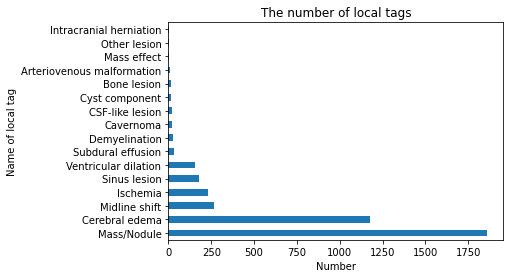

In [141]:
plot_tag = df_data['Tag'].value_counts()
plot_tag.plot(kind='barh')
plt.title("The number of local tags")
plt.ylabel("Name of local tag")
plt.xlabel("Number")
plt.savefig('tag_eda.png', dpi=600, format='png', bbox_inches='tight')

In [138]:
list_studyuid = []
for key,value in enumerate(df_data['StudyUID']):
    list_studyuid.append(value[0])
set_studyuid = set(list_studyuid)
print(len(list_studyuid))
# print(set_seriesuid)

4023


In [139]:
list_seriesuid = []
for key,value in enumerate(df_data['SeriesUID']):
    list_seriesuid.append(value)
set_seriesuid = set(list_seriesuid)
print(len(set_seriesuid))
# print(set_seriesuid)

132


In [140]:
for seriesuid in list(set_seriesuid):
    df_one = df_data[df_data['SeriesUID']==seriesuid].sort_values(by='SliceIndex')
    df_one['SliceIndex'].value_counts()

13     116
8      113
12     113
11     111
9      110
      ... 
232      1
230      1
28       1
26       1
243      1
Name: SliceIndex, Length: 245, dtype: int64

In [58]:
def read_dicom(path, voi_lut = True, fix_monochrome = True):
    dicom = pydicom.read_file(path)
    
    # VOI LUT (if available by DICOM device) is used to transform raw DICOM data to "human-friendly" view
    if voi_lut:
        data = apply_voi_lut(dicom.pixel_array, dicom)
    else:
        data = dicom.pixel_array
               
    # depending on this value, X-ray may look inverted - fix that:
    if fix_monochrome and dicom.PhotometricInterpretation == "MONOCHROME1":
        data = np.amax(data) - data
        
    data = data - np.min(data)
    data = data / np.max(data)
    data = (data * 255).astype(np.uint8)
        
    return data

In [59]:
def display_series_images(imgs, bboxes, labelNames, slice_index, saved_name):
    """
    Plot annotation into a series of images
    Input:
    - imgs: array-like pixel of image
    - bboxes: 2D array of bounding boxes for corresponding images where each element is (x,y,w,h) - (bottomleftx, bottemlefty, width, height)
    Output:
    - Matplotlib figure of brain mri with bbounding boxes
    """
    assert(len(imgs) == len(bboxes))

    fig, axes = plt.subplots(1,len(imgs), figsize=(39, 39))

    for i in range(len(imgs)):
        rect = patches.Rectangle((bboxes[i][0], bboxes[i][1]), bboxes[i][2], bboxes[i][3], linewidth=6, edgecolor='r', facecolor='none')
        axes[i].add_patch(rect)
        axes[i].text(bboxes[i][0], bboxes[i][1], labelNames[i], fontsize=49, color='white')
        axes[i].imshow(imgs[i])
        axes[i].title.set_text(f'Slice {slice_index[i]}')
        axes[i].xaxis.set_visible(False)
        axes[i].yaxis.set_visible(False)
        axes[i].figure.set_size_inches(39, 39)
    plt.subplots_adjust(wspace=0.025, hspace=0.025)
    
    plt.savefig(saved_name)

    return fig

In [ ]:
def visualize_series_images(choisen_seriesUID, dframeBbox, ROOT_PATH_DCM, ROOT_SAVED_IMAGES):
    """
    
    """
    df_one_seriesUID = dframeBbox[dframeBbox['SeriesUID']==choisen_seriesUID].sort_values(by='SliceIndex')
    df_one_seriesUID = df_one_seriesUID.reset_index()
    
    dcm_paths = [os.path.join(ROOT_PATH_DCM, df_one_seriesUID['StudyUID'][i][0], df_one_seriesUID['DicomFileName'][i]) for i in range(len(df_one_seriesUID['DicomFileName']))]
    dcms = [read_dicom(dcm_path) for dcm_path in dcm_paths]
    bboxes = [bbox for bbox in df_one_seriesUID['Bbox']]
    labelNames = [name for name in df_one_seriesUID['Tag']]
    indexSlices = [idx for idx in df_one_seriesUID['SliceIndex']]

    for i in range(len(dcms)):
        display_image(dcms[i], bboxes[i], labelNames[i], indexSlices[i], saved_path=os.path.join(ROOT_SAVED_IMAGES, df_one_seriesUID['DicomFileName'][i].split('.dcm')[0]+'.png'))

In [87]:
def display_image(img, bbox, labelName, slice_index, saved_path):
    """
    Plot annotation into a image with bounding box
    Input:
    - img: array-like pixel of image
    - bbox: 2D array of bounding boxes for corresponding images where each element is (x,y,w,h) - (bottomleftx, bottemlefty, width, height)
    Output:
    - Matplotlib figure of brain mri with bbounding boxes
    """
    fig, ax = plt.subplots()
    rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=6, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    ax.text(bbox[0], bbox[1], labelName, fontsize=69, color='white')
    ax.imshow(img)
    ax.title.set_text(f'Slice {slice_index}')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.figure.set_size_inches(69, 69)
    plt.subplots_adjust(wspace=0.025, hspace=0.025)
    plt.savefig(saved_path)
    return fig

In [88]:
list_seriesuid = []
for key,value in enumerate(df_data['SeriesUID']):
    list_seriesuid.append(value)
set_seriesuid = set(list_seriesuid)
print(len(set_seriesuid))
# print(set_seriesuid)

132


In [89]:
index = 113
choisen_seriesUID = list(set_seriesuid)[index]
df_one_seriesUID = df_data[df_data['SeriesUID']==choisen_seriesUID].sort_values(by='SliceIndex')
df_one_seriesUID = df_one_seriesUID.reset_index()
df_one_seriesUID

,index,SliceIndex,Bbox,Tag,LesionIndex,DicomFileName,SeriesUID,StudyUID
0,2024,4,"[168.10217959097506, 299.5527592537556, 94.21794412397148, 86.7796071596905]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.746.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
1,2025,5,"[153.65352644853886, 289.91025626866406, 124.88958805108535, 104.03242547179678]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.759.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
2,2026,6,"[140.00867828341944, 280.7248432128851, 153.72396046204585, 120.2517774417164]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.747.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
3,2027,7,"[142.96469248161554, 283.37697967985093, 143.69450035535658, 114.85128798880004]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.760.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
4,2028,8,"[146.79285128633592, 287.04167124710256, 131.47117210102027, 108.26948252620582]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.748.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
5,2029,8,"[149.10618909256678, 332.55809963970165, 45.86932283369103, 53.307447492918584]",Mass/Nodule,1,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.748.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
6,2030,9,"[150.6210100910563, 290.7063628143542, 119.24784384668402, 101.68767706361172]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.761.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
7,2031,9,"[145.26227319128625, 332.8324999352668, 50.934624624660586, 55.558687807048045]",Mass/Nodule,1,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.761.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
8,2032,10,"[154.4491688957766, 294.3710543816057, 107.02451559234777, 95.10587160101761]",Cerebral edema,0,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.749.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]
9,2033,10,"[140.84795013454809, 333.56322189154497, 57.02664888234304, 58.266248218947]",Mass/Nodule,1,1.2.840.113619.2.410.15512023.5814788.13088.1602729687.749.dcm,1.2.840.113619.2.410.15512023.5814788.13598.1602729418.985,[1.2.840.113619.6.410.283423224305112722086381747904404575437]


In [90]:
ROOT_PATH = '/home/single1/BACKUP/tintrung/brain-mri-tumor-dicom-masked'

dcm_paths = [os.path.join(ROOT_PATH, df_one_seriesUID['StudyUID'][i][0], df_one_seriesUID['DicomFileName'][i]) for i in range(len(df_one_seriesUID['DicomFileName']))]
dcms = [read_dicom(dcm_path) for dcm_path in dcm_paths]
bboxes = [bbox for bbox in df_one_seriesUID['Bbox']]
labelNames = [name for name in df_one_seriesUID['Tag']]
indexSlices = [idx for idx in df_one_seriesUID['SliceIndex']]


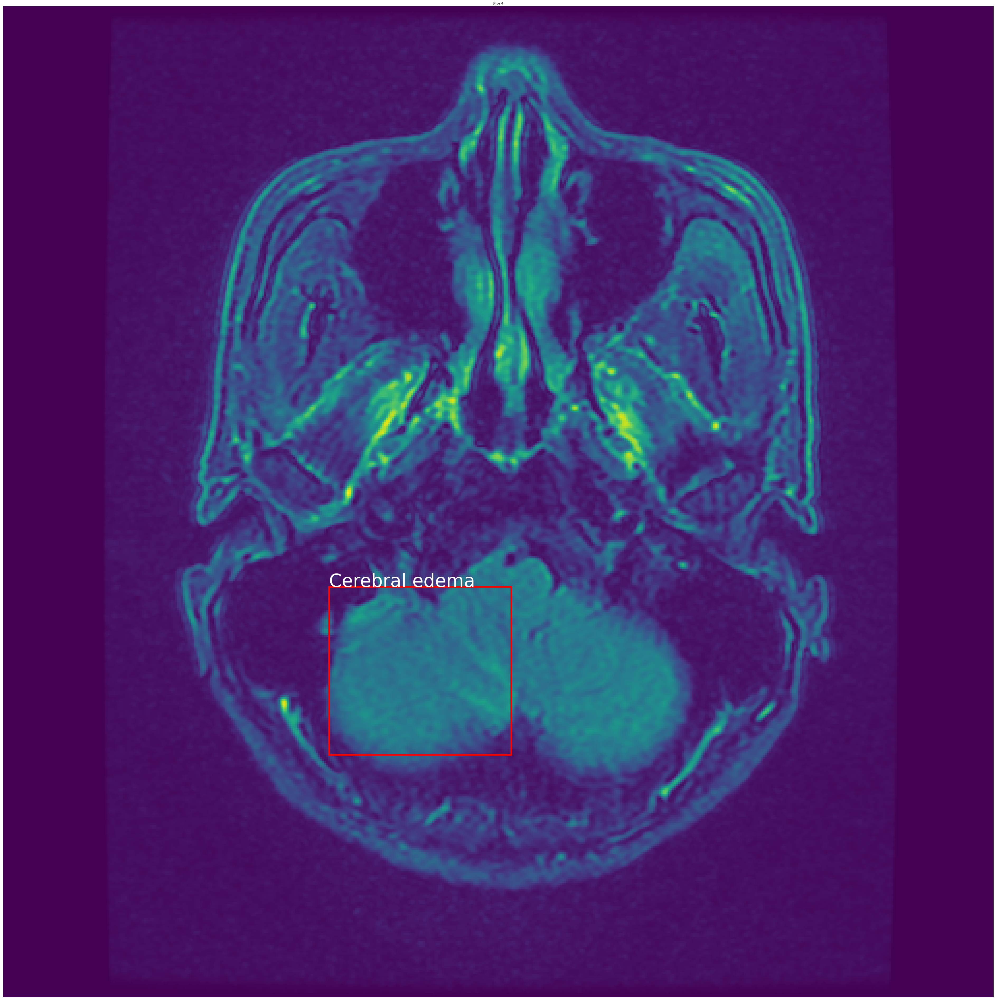

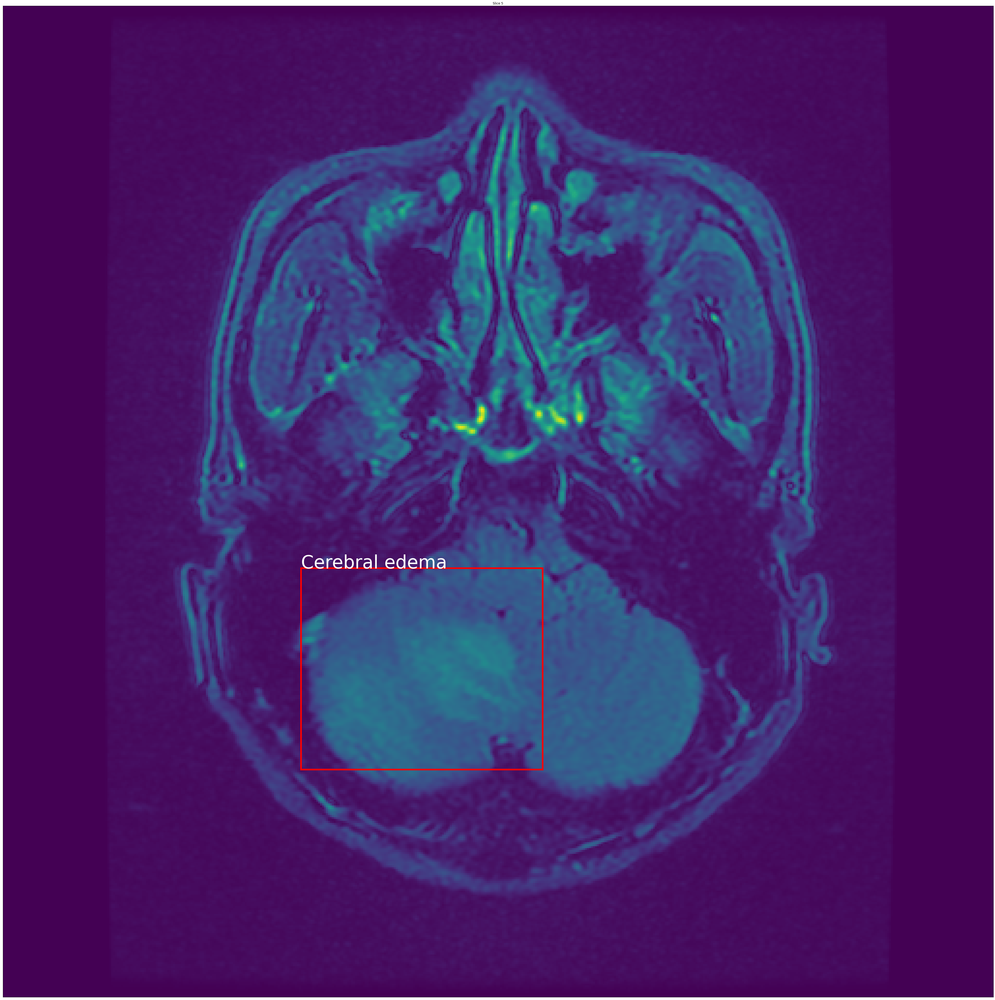

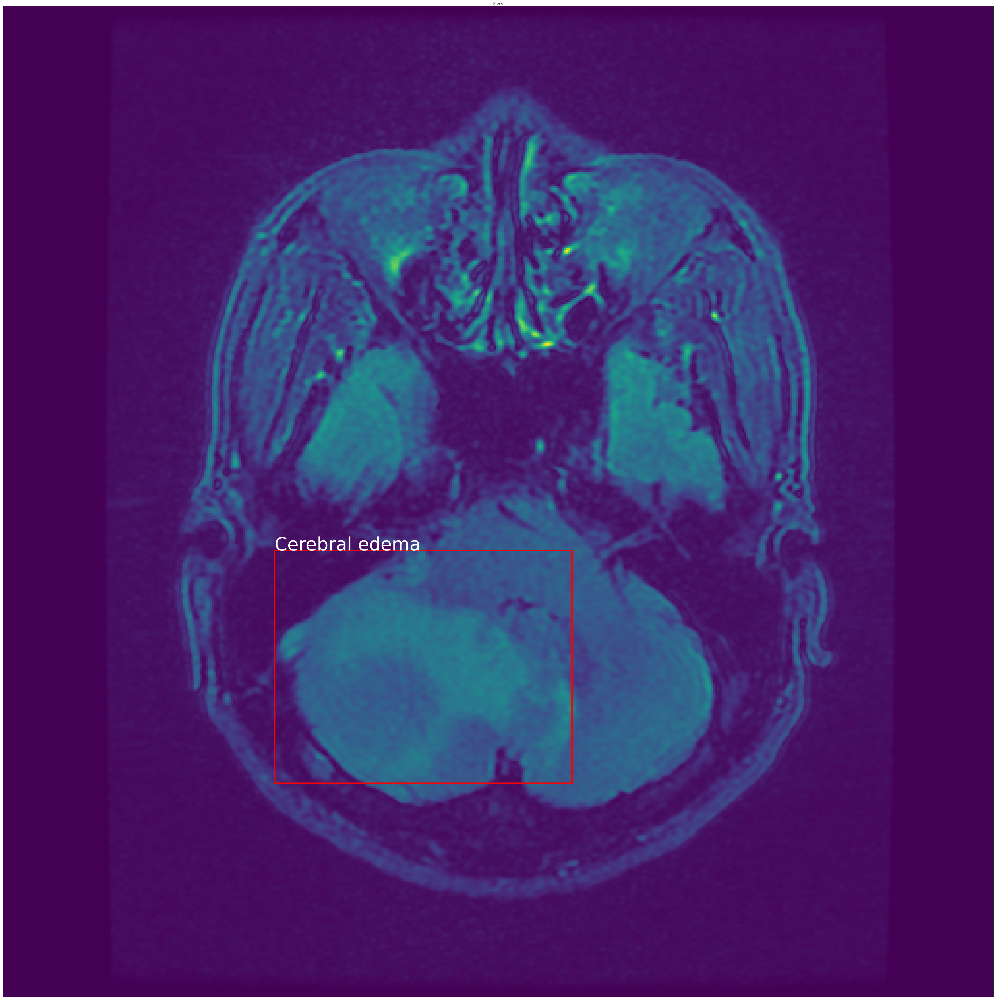

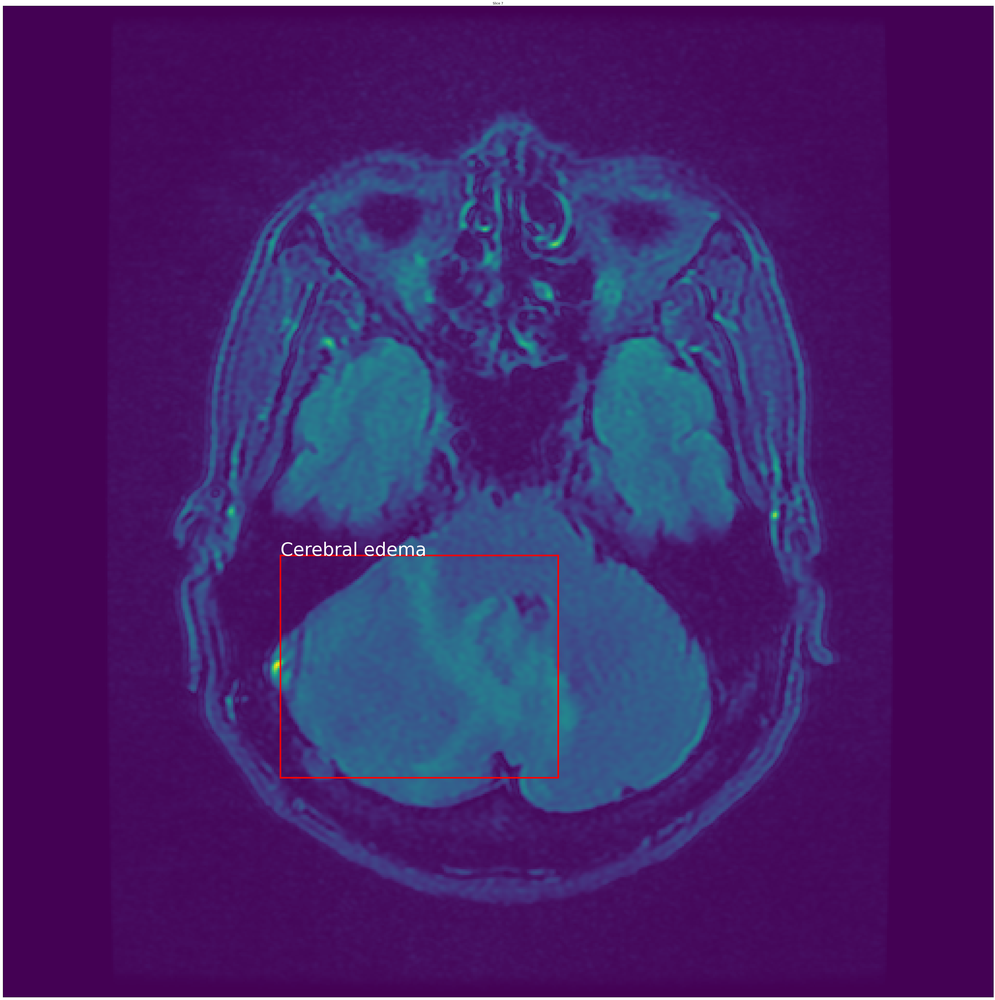

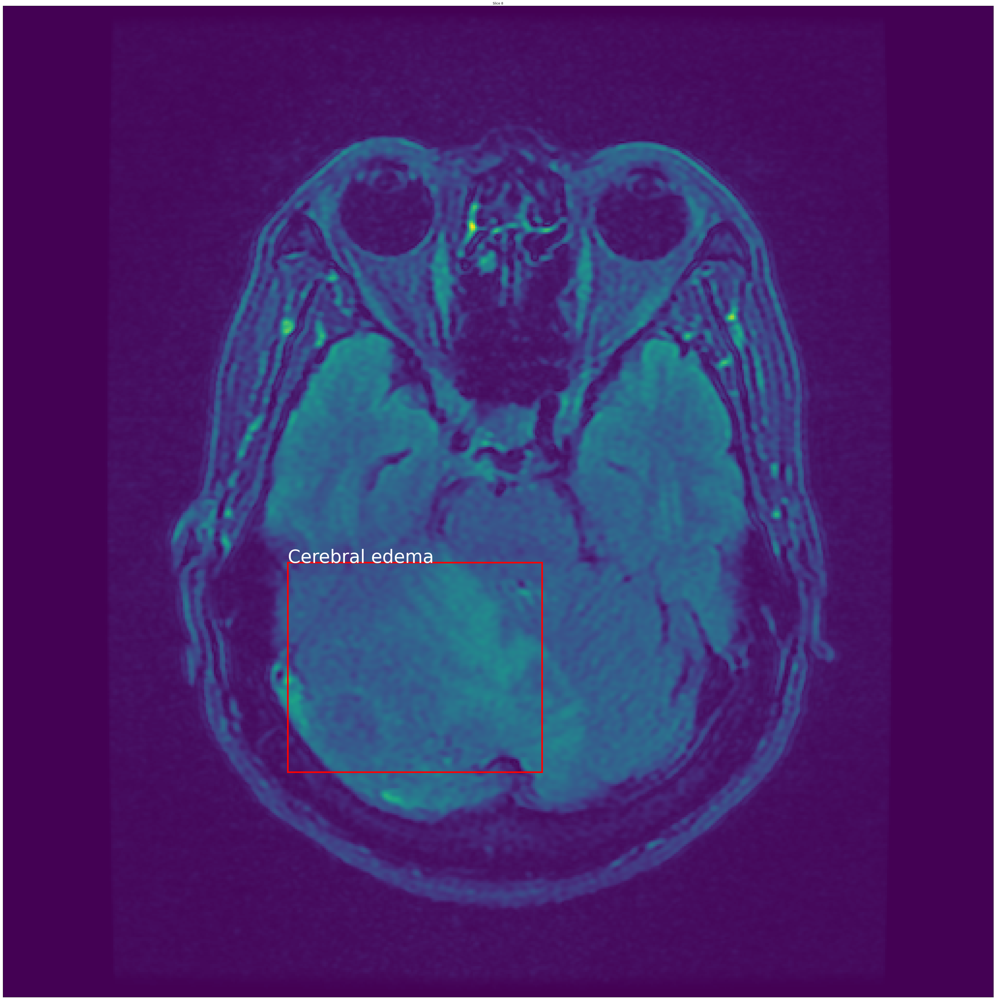

...

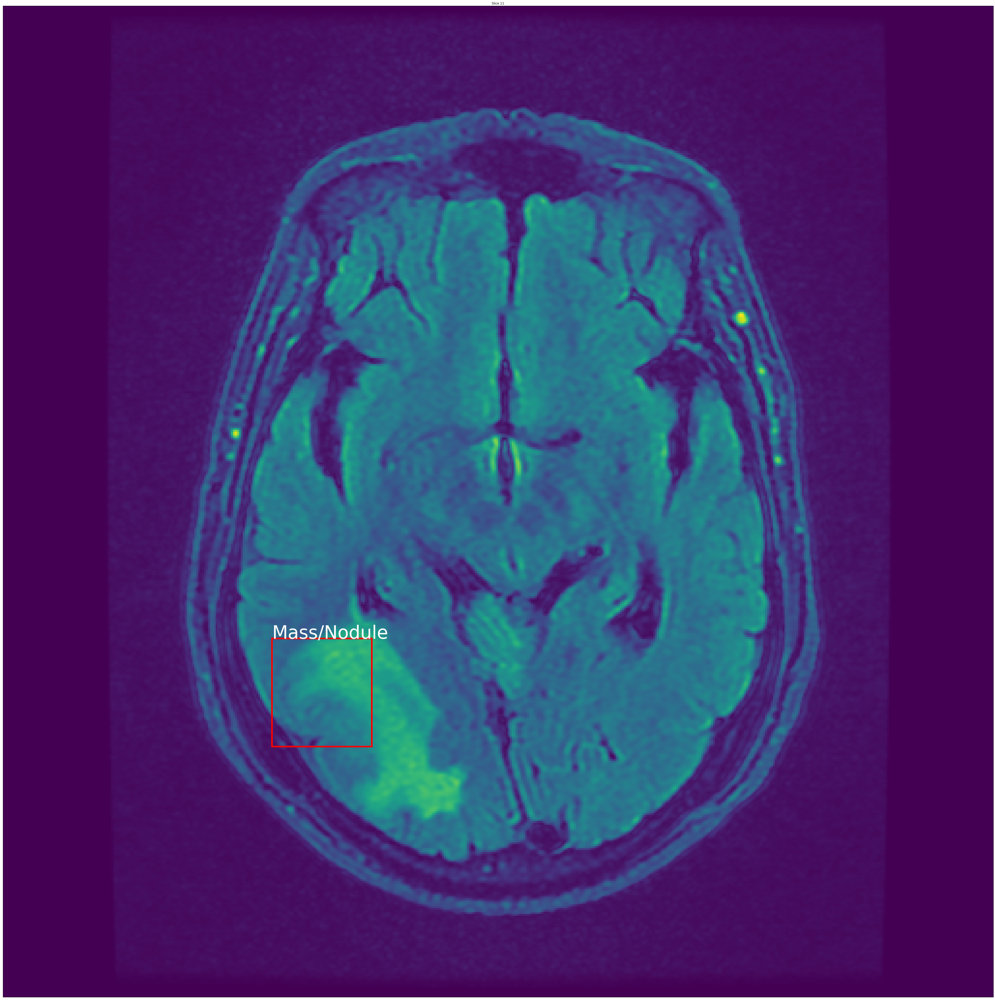

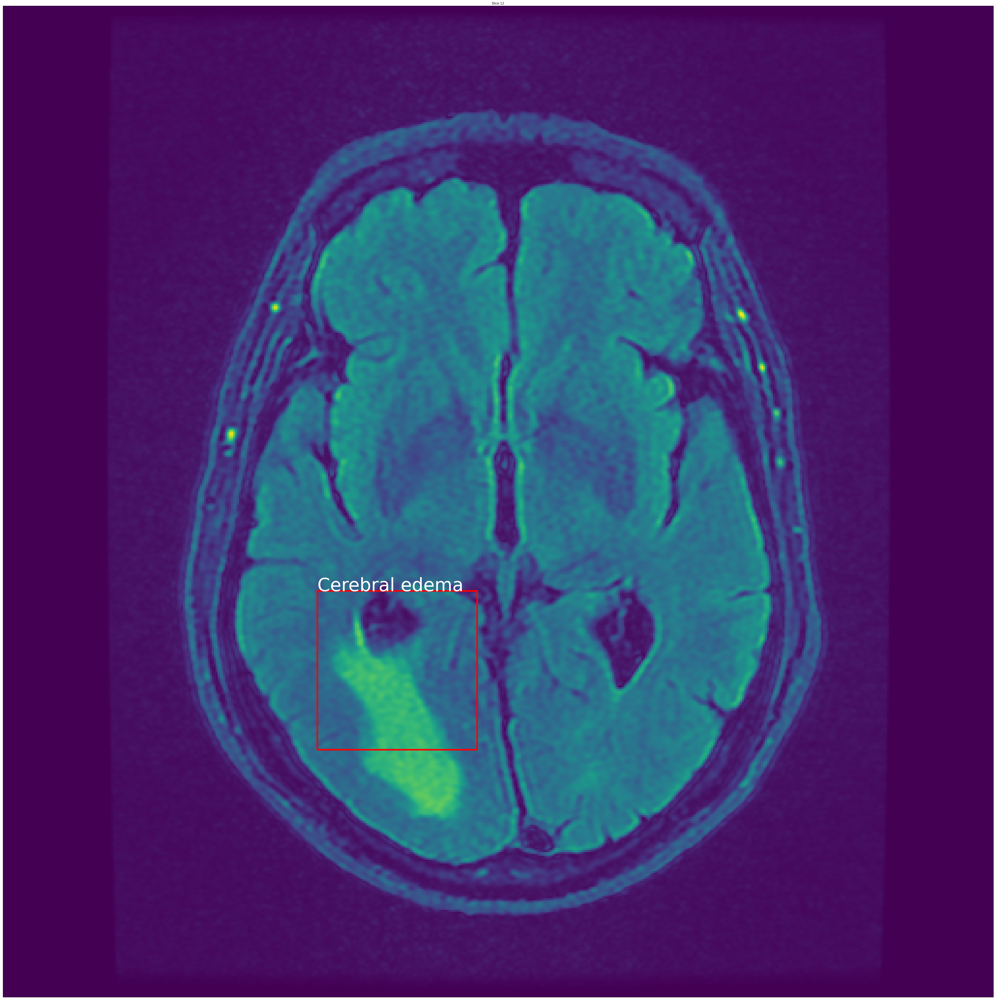

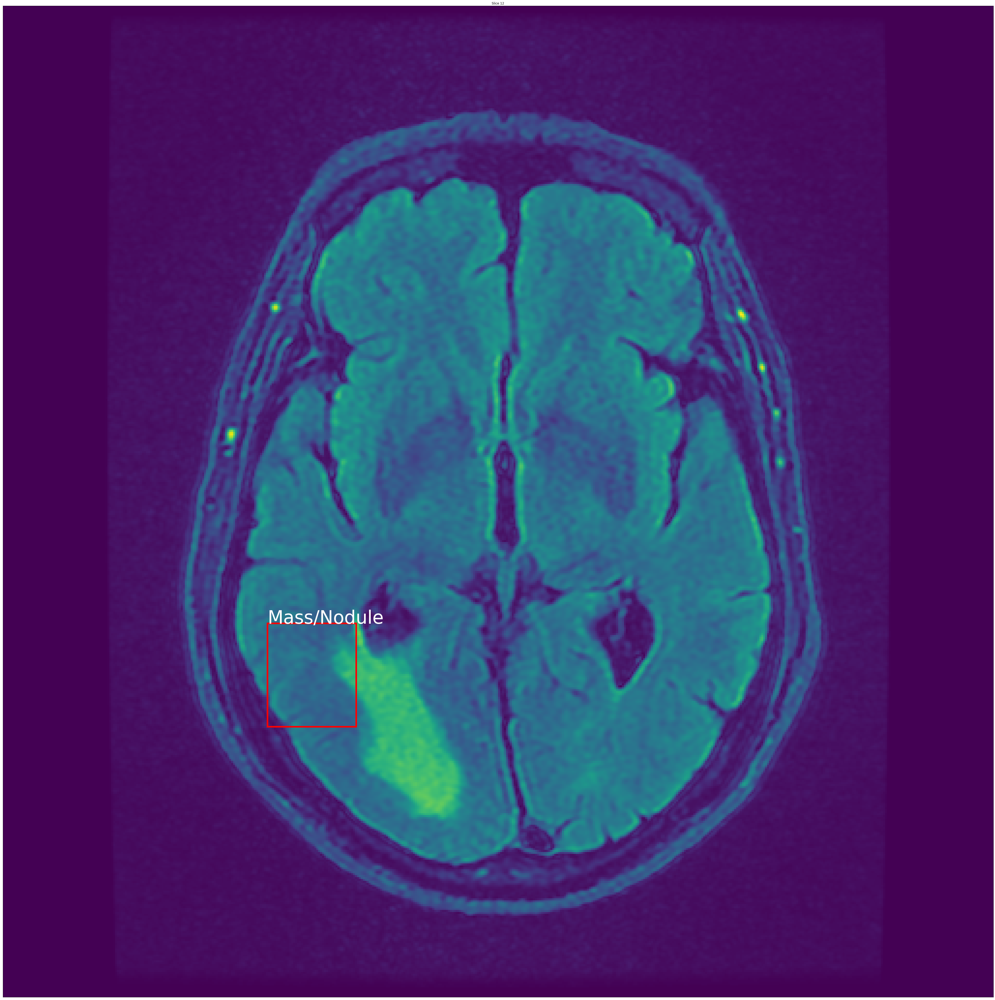

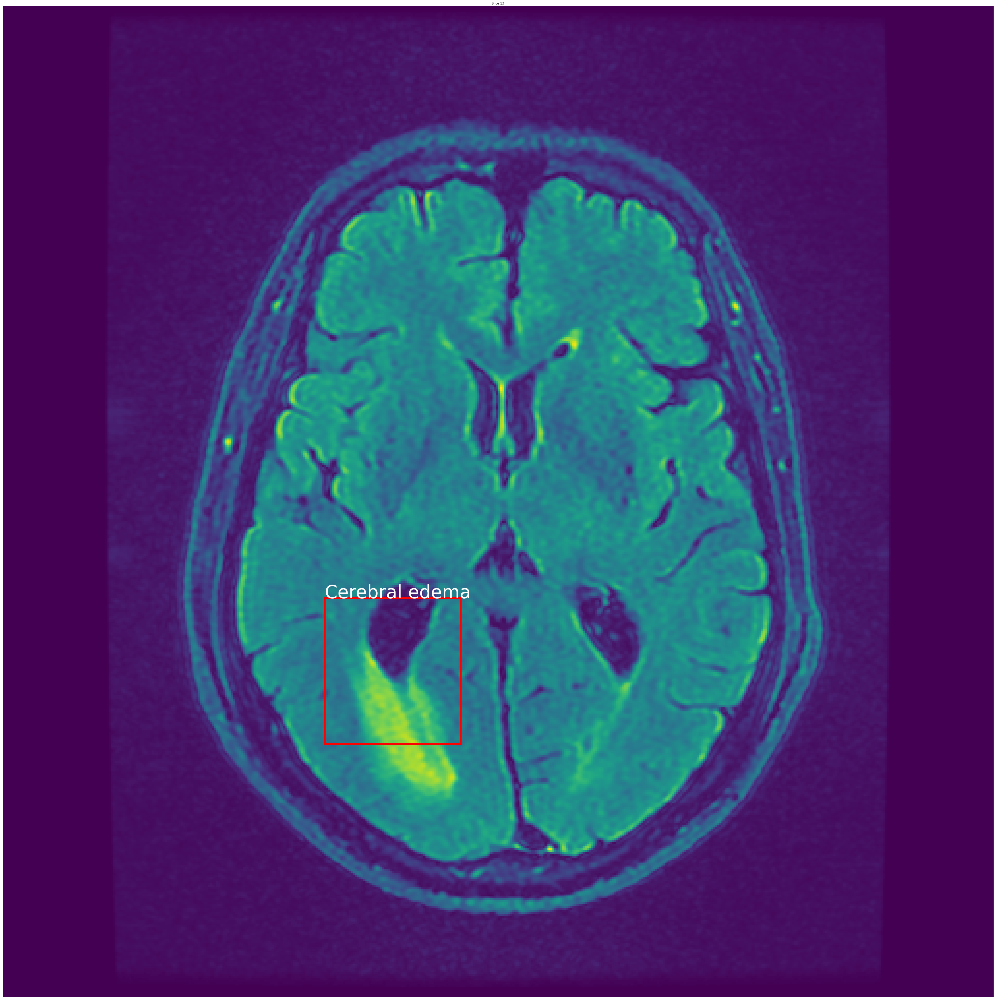

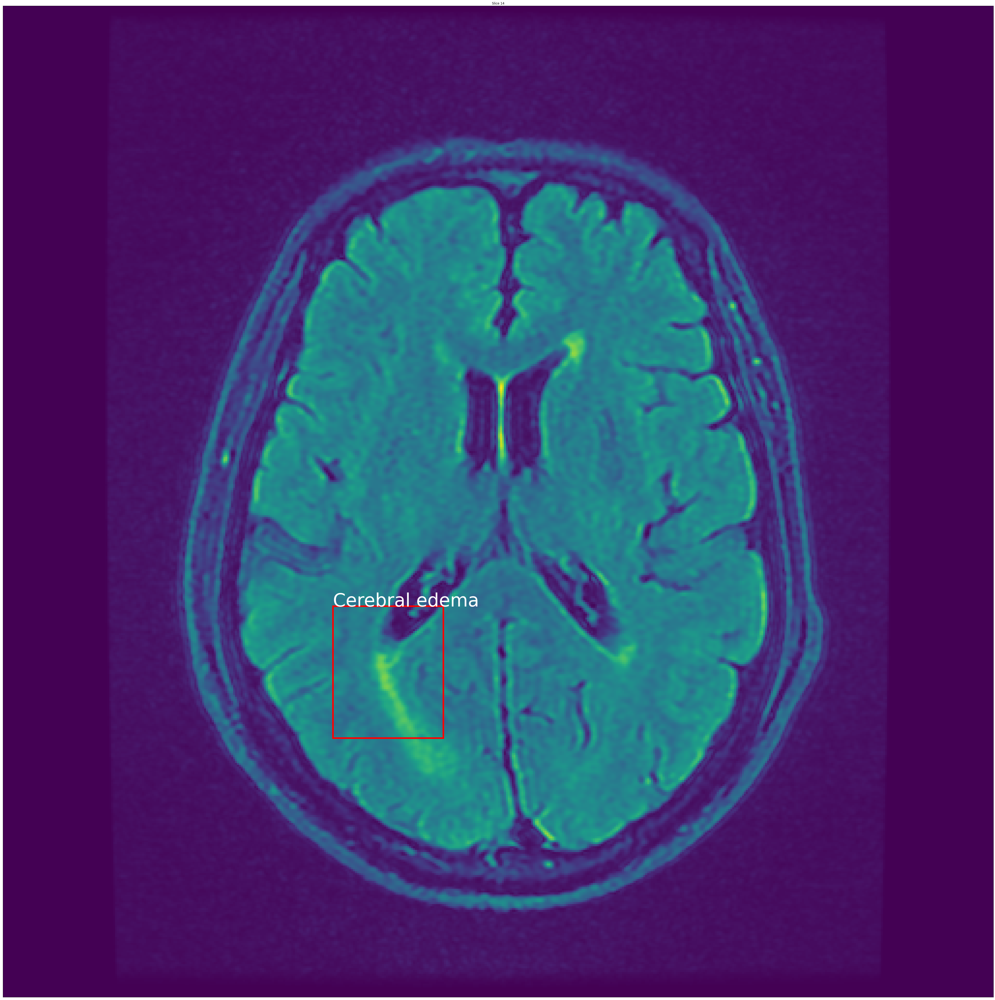

In [92]:
ROOT_SAVED_IMAGES = '/home/single1/BACKUP/tintrung/brainmri/tinnvt/display_imgs'
for i in range(len(dcms)):
    display_image(dcms[i], bboxes[i], labelNames[i], indexSlices[i], saved_path=os.path.join(ROOT_SAVED_IMAGES, df_one_seriesUID['DicomFileName'][i].split('.dcm')[0]+'.png'))